# Laboratory #2_2 : Corner detection and ORB

At the end of this laboratory, you would get familiarized with

*   Corner Detection using FAST and Harris Corners
*   ORB feature detectors and descriptors

**Remember this is a graded exercise.**

*   For every plot, make sure you provide appropriate titles, axis labels, legends, wherever applicable.
*   Create reusable functions where ever possible, so that the code could be reused at different places.
*   Mount your drive to access the images.
*   Add sufficient comments and explanations wherever necessary.

---

Authors:
- Joaquim Marset Alsina
- Jesús Molina Rodríguez de Vera

In [ ]:
# mount drive to the notebook

from google.colab import drive
drive.mount('/content/drive')
parent_folder = "/content/drive/MyDrive/CV - Lab/Lab5"

Mounted at /content/drive


In [ ]:
# Loading necessary libraries (Feel free to add new libraries if you need for any computation)

import numpy as np
from matplotlib import pyplot as plt
import os
from skimage import color, data, feature, filters, io, transform 

# Corner Detection

### Exercise: #1

*    Detect the corners in the image starbucks4.jpg. Use corner_fast to extract FAST corners for the given image and corner_peaks to find corners in the corner measure response image.
*   Show the original image, fast corners, peaks overlayed on the original image using matplotlib subplot.



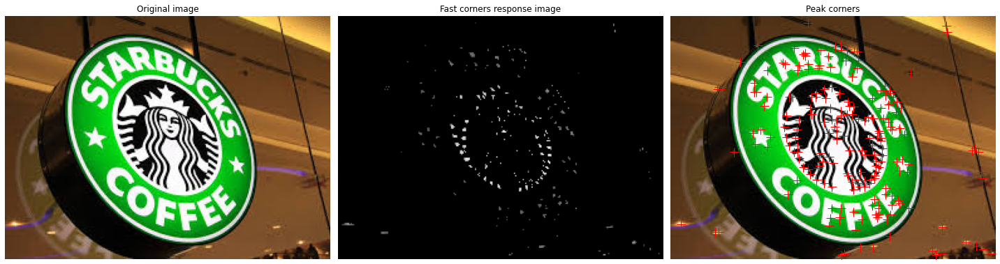

In [ ]:
# solution
starbucks_img = io.imread(os.path.join(parent_folder, "images", "starbucks/starbucks4.jpg"))
# The image must be grayscale (2D array required)
starbucks_img_gray = color.rgb2gray(starbucks_img)
fast_corners_response = feature.corner_fast(starbucks_img_gray)
corners_peaks = feature.corner_peaks(fast_corners_response)

fig, axes = plt.subplots(1,3)

fig.set_size_inches(20,7)

for ax in axes.flatten():
  ax.axis("off")

axes[0].imshow(starbucks_img)
axes[0].set_title("Original image")
axes[1].imshow(fast_corners_response, cmap="gray")
axes[1].set_title("Fast corners response image")
axes[2].imshow(starbucks_img)
axes[2].plot(corners_peaks[:, 1], corners_peaks[:, 0], '+r', markersize=13)
axes[2].set_title("Peak corners");

fig.tight_layout()

*   Analyze and discuss the effect of changing **'threshold'** in the corner_fast function.

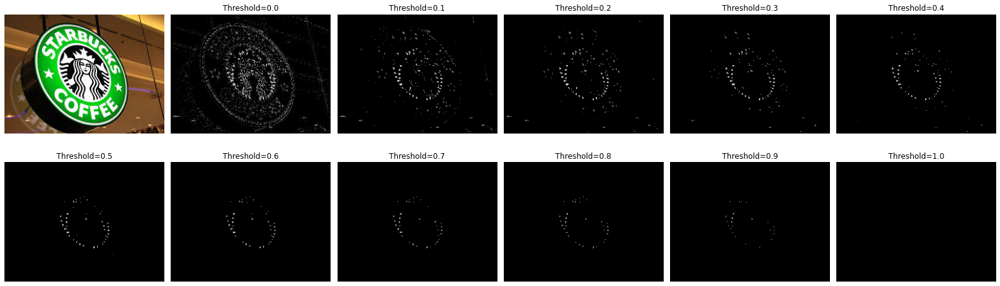

In [ ]:
fig, axes = plt.subplots(2, 6)

for ax in axes.flatten():
  ax.axis("off")

fig.set_size_inches(22, 7)

axes[0][0].imshow(starbucks_img)

for i, th in enumerate(np.linspace(0, 1, 11)):
  j=i+1
  ax = axes[j//6, j%6]
  response = feature.corner_fast(starbucks_img_gray, threshold=th)
  ax.imshow(response, cmap="gray")
  ax.set_title(f"Threshold={th:.1f}")

fig.tight_layout()

**Solution**

According to the documentation, the parameter `threshold`:

> Threshold used in deciding whether the pixels on the circle are brighter, darker or similar w.r.t. the test pixel. 
Decrease the threshold when more corners are desired and vice-versa.

To understand that, it is paramount to understand how the FAST algorithm works ([link to the paper](https://doi.org/10.1007%2F11744023_34)). Particularly, we will focus on the segment test detector. The idea is comparing the brightness of every pixel $p$ or test pixel, $I_p$ with the surrounding pixels in a circle of $N$ pixels. The pixel $p$ is classified as a corner if:
- A given number of $n$ pixels in this circle are brighter than $I_p+threshold$.
- A given number of $n$ pixels in the circle are darker than $I_p-threshold$.

To make the algorithm faster, at first only $4$ pixels of the circle are tested. If at least $3$ of those $4$ pixels meet any of the criteria, then the whole circle is considered. Otherwise, the point is directly discarded.

Therefore, this value controls how restrictive the algorithm is when classifying points as corners. The higher the value, the higher the difference of the surrounding should be.

We can appreciate that effect in the images displayed above. As we can see, when `threshold=0` the algorithm detects a lot of points as corners. The number of points detected decreases until we reach `threshold=1`, where no corner is detected. That is because in floating images in the range $[0,1]$, it is not possible to have differences greater than $1$ (obviously). 


*   Repeat the exercise by replacing FAST corners with Harris corners.

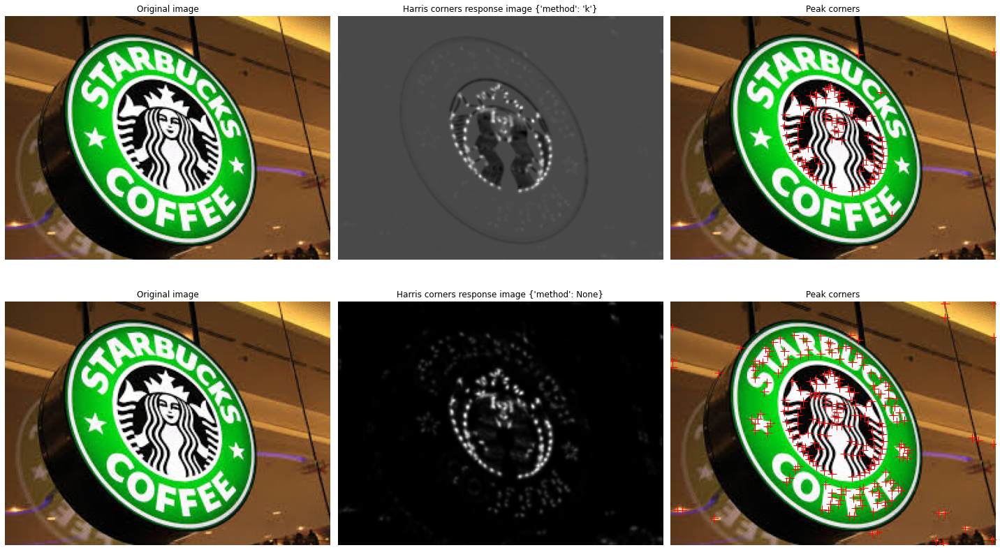

In [ ]:
# solution

fig, axes = plt.subplots(2,3)

fig.set_size_inches(20,12)

for ax in axes.flatten():
  ax.axis("off")


def plot_harris_corners(img, axes, *args, **kwargs):
    axes[0].imshow(img)
    axes[0].set_title("Original image")
    # We use the grayscale image again
    harris_corners_response = feature.corner_harris(color.rgb2gray(img), *args, **kwargs)
    corners_peaks = feature.corner_peaks(harris_corners_response)
    axes[1].imshow(harris_corners_response, cmap="gray")
    axes[1].set_title(f"Harris corners response image {kwargs}")
    axes[2].imshow(img)
    axes[2].plot(corners_peaks[:, 1], corners_peaks[:, 0], '+r', markersize=13)
    axes[2].set_title("Peak corners");


# Method = k
plot_harris_corners(starbucks_img, axes[0,:], method='k')

# Method!=k
plot_harris_corners(starbucks_img, axes[1,:], method=None)

fig.tight_layout();

*   Do you find difference between both the techniques? If so, why and what difference do you observe?

**Solution**

An introduction to how the Harris corner detector works can be found in the [Appendix A](#app-a). We have decided to show the result of the Harris corner detector with both types of response image (`method=k` or `method!=k`).

According to that explanation, both methods (FAST and Harris) use different definitions of corner: one is based on intensity changes in a circle and the other in the direction of changes.

Regarding the results, we can see clear differences between both approaches. The latter is much similar to the output of the FAST algorithm, both the response image and consequently the final peak corners.

The former, however, clearly differs from what we have seen before. A first difference is related to the response images themselves:
- With the FAST algorithm and the second version of Harris, we can see a mostly black image that presents some grey and white areas.
- With the Harris corner detector, the image is mainly grey with some black and white areas.

Moreover, we can see that the FAST algorithm is much more likely to have "false positives" than the first Haris approach. We can see that, for example,  corners are found in the waves of the hair in the logo. From our perspective, a smooth curve should never be considered as a corner, and therefore, the system is failing.

On the other hand, the first Harris approach is prone to ignoring some points that are indeed corners. We can observe that, for instance, only two corners are detected in the letters (when there are most of them).

Because of that, it is difficult to choose one of the options (FAST or any of the Harris variants) as better than the others.

# ORB feature detector and binary descriptor

### Exercise #0: Compute ORB descriptors and find descriptors match

*   Load 'astronaut' image from data module.
*   Convert the image to grayscale.
*   Create a copy of the image and rotate it by 180&deg; 



In [ ]:
img1 = color.rgb2gray(data.astronaut())
img2 = transform.rotate(img1, 180)

*   Create an ORB feature detector with default parameters. *Hint: ORB feature detector is available in skimage.feature module.*



In [ ]:
descriptor_extractor = feature.ORB(n_keypoints=200)

*   Extract the keypoints and descriptors using detect_and_extract function for both the images

In [ ]:
descriptor_extractor.detect_and_extract(img1)
keypoints1 = descriptor_extractor.keypoints
descriptors1 = descriptor_extractor.descriptors

descriptor_extractor.detect_and_extract(img2)
keypoints2 = descriptor_extractor.keypoints
descriptors2 = descriptor_extractor.descriptors

*   Descriptors can be matched using match_descriptors function available in skimage.feature module
*   The matches can be plotted using the plot_matches function available in skimage.feature module

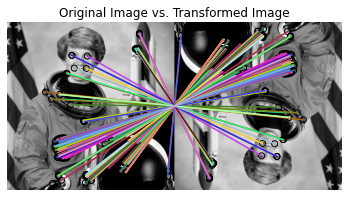

In [ ]:
matches12 = feature.match_descriptors(descriptors1, descriptors2, cross_check=True)
feature.plot_matches(plt, img1, img2, keypoints1, keypoints2, matches12)
plt.axis('off')
plt.title("Original Image vs. Transformed Image")
plt.show()

### Exercise: #1

*   Analyze and discuss the effect of changing the parameter **'max_ratio'** in the match_descriptors function.

In [ ]:
def plot_max_ratio_values(increment, initial_value=0.0, end_value=1.0):
    max_ratio_values = np.arange(initial_value, end_value+increment, increment)
    matches_values = []

    for max_ratio in max_ratio_values:
        matches = feature.match_descriptors(descriptors1, descriptors2, cross_check=True, max_ratio=max_ratio)
        matches_values.append(len(matches))

    plt.plot(max_ratio_values, matches_values)

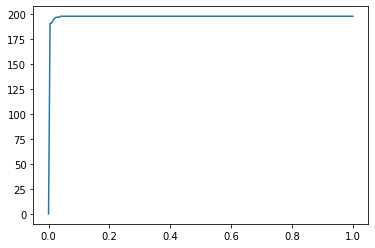

In [ ]:
plot_max_ratio_values(0.005)

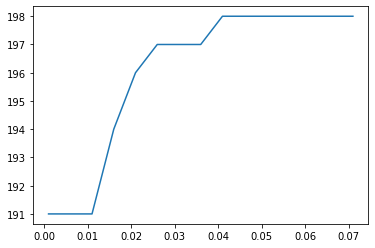

In [ ]:
plot_max_ratio_values(0.005, 0.001, 0.07)

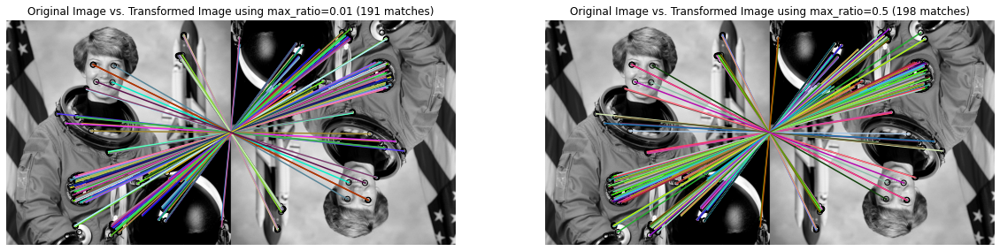

In [ ]:
fig, axs = plt.subplots(1, 2)

fig.set_size_inches(20, 10)

axs[0].axis('off')
axs[1].axis('off')

matches_1 = feature.match_descriptors(descriptors1, descriptors2, cross_check=True, max_ratio=0.01)
matches_2 = feature.match_descriptors(descriptors1, descriptors2, cross_check=True, max_ratio=0.5)

feature.plot_matches(axs[0], img1, img2, keypoints1, keypoints2, matches_1)
feature.plot_matches(axs[1], img1, img2, keypoints1, keypoints2, matches_2)

axs[0].set_title("Original Image vs. Transformed Image using max_ratio=0.01 (191 matches)")
axs[1].set_title("Original Image vs. Transformed Image using max_ratio=0.5 (198 matches)")

plt.show()

In [ ]:
matches_3 = feature.match_descriptors(descriptors1, descriptors2, cross_check=True, max_ratio=0.05)
matches_4 = feature.match_descriptors(descriptors1, descriptors2, cross_check=True, max_ratio=0.8)
print(np.all(matches_3 == matches_4))

True


In [ ]:
# Extracted from the source code of match_descriptors
# https://github.com/scikit-image/scikit-image/blob/main/skimage/feature/match.py#L5-L97

from scipy.spatial.distance import cdist

distances = cdist(descriptors1, descriptors2, metric='hamming')

indices1 = np.arange(descriptors1.shape[0])
indices2 = np.argmin(distances, axis=1)

matches1 = np.argmin(distances, axis=0)
mask = indices1 == matches1[indices2]
indices1 = indices1[mask]
indices2 = indices2[mask]

best_distances = distances[indices1, indices2]

print(f'Matches with distance = 0: {np.sum(best_distances == 0)}')
print(f'Matches with distance > 0: {np.sum(best_distances > 0)}, Values: {best_distances[best_distances > 0]}')

Matches with distance = 0: 191
Matches with distance > 0: 7, Values: [0.00390625 0.00390625 0.00390625 0.00390625 0.0078125  0.01171875
 0.00390625]


**Solution**

The `max_ratio` parameter fixes the maximum ratio it can exist between the distances of the first and second match of a descriptor of the first set with a descriptor of the second set. That is, for each descriptor of the first set, it computes the best match with the second set by computing the distance, which will be the minimum. Then, it will ignore that best match and try to find the second one in terms of minimum distance.  
If the ratio of the distances between both best matches is smaller than the `max_ratio` the match will be accepted, otherwise filtered.  
Therefore, it can be seen as a way of filtering ambiguous matches that can be very close in distance.

In the case of this particular pair of images, where the second one is simply the first rotated, the `max_ratio` does not have almost any effect. This can be observed in the plots shown in the first cells, where the number of matches between descriptors does not change from a `max_ratio` of 0.004 onwards. There is only some variation between the range $(0, 0.004]$.  
This is because, as it can be observed in the previous cell, most of the best matches have distance 0, and when computing the ratio with the second-best match results in 0. Only those that have a distance bigger than 0 as the first best match are filtered depending on the value of `max_ratio`.

Most of the matches have distances 0 because the image is simply a rotation of the first one, so when computing the keypoints using FAST, the pixels of the circle will be the same but rotating the circle, resulting
in the same keypoints. The effect of rotation is mostly present when obtaining the feature descriptors with BRIEF, which is more sensitive to rotation, particularly when performing an in-plane rotation as we have done by rotating the image by 180º. We believe that, even though ORB modifies BRIEF (rBRIEF) to account for rotation problems, it is not perfect, leading to those distances different than 0 ([ORB algorithm explanation](https://medium.com/data-breach/introduction-to-orb-oriented-fast-and-rotated-brief-4220e8ec40cf)).

In any case, we see how with most of the possible values of `max_ratio` we obtain the same number of matches, and in those cases, the matches are perfect between both images (an indicator of the correct matches is the fact that all the lines intersect at one point, given that one image is the other rotated by 180º). When the value of `max_raito` is very small, we filter 7 matches because the distance different to 0.


*   What do you infer from **'harris_k'**, **'n_scales'**, **'fast_n'**, **'fast_threshold'** parameters in ORB function?

**Solution**

`harris_k` refers to the $k$ value used in the computation of the Harris score defined in [Appendix A](#app-a) (the default method). Harris is applied to the extracted keypoints after applying the FAST algorithm, and before computing the descriptors with BRIEF, to ensure the number of found keypoints matches the specified by the parameter. The idea for ORB to use Harris is to ensure the number of returned corners is the one specified as a parameter, and Harris achieves it by filtering corners from edges and keeping the best ones. Bigger values will only let pass corners that are not too sharp.

`n_scales` refers to the number of scales ORB uses to scale the image (downsampling it), creating an image pyramid ([Example of the image pyramid](https://medium.com/data-breach/introduction-to-orb-oriented-fast-and-rotated-brief-4220e8ec40cf)), and apply the FAST algorithm to each scale to extract keypoints. This way ORB achieves some kind of scale invariability that FAST does not have.

Both `fast_n` and `fast_threshold` refer to parameters from the FAST corner detection algorithm ([Explanation of FAST algorithm](https://medium.com/data-breach/introduction-to-fast-features-from-accelerated-segment-test-4ed33dde6d65)).  
FAST works by considering for each pixel that can be a keypoint candidate (called $p$) a circle of a certain number of pixels as we have explained in the previous exercises. Typically, this number of pixels is 16.

The `fast_n` parameter refers to the minimum number of pixels out of the 16 forming the circle that must form the mentioned subset of $n$ pixels that must be brighter or darker than $p$. The `fast_threshold` parameter precisely refers to the mentioned threshold that the algorithm sums/substracts to/from the intensity of the pixel $p$ to compare with the subset of $n$ pixels.

### Exercise: #2
*   Using the above example, create a function get_ORB, that takes two images as parameters and returns the keypoints of both images and descriptor matches

In [ ]:
# solution
# We also add the number of keypoints to extract from each image, and the max_ratio to filter matches
# This will come in handy when performing later exercises
def get_ORB(gray_image1, gray_image2, n_keypoints=200, max_ratio=1.0):
    descriptor_extractor = feature.ORB(n_keypoints=n_keypoints)

    descriptor_extractor.detect_and_extract(gray_image1)
    keypoints1 = descriptor_extractor.keypoints
    descriptors1 = descriptor_extractor.descriptors

    descriptor_extractor.detect_and_extract(gray_image2)
    keypoints2 = descriptor_extractor.keypoints
    descriptors2 = descriptor_extractor.descriptors

    matches = feature.match_descriptors(descriptors1, descriptors2, cross_check=True, max_ratio=max_ratio)

    return keypoints1, keypoints2, matches

*   Using the above function, detect the correspondences between the model image 'starbucks.jpg' with the scene image 'starbucks4.jpg'
*   Plot the matches between the two images.

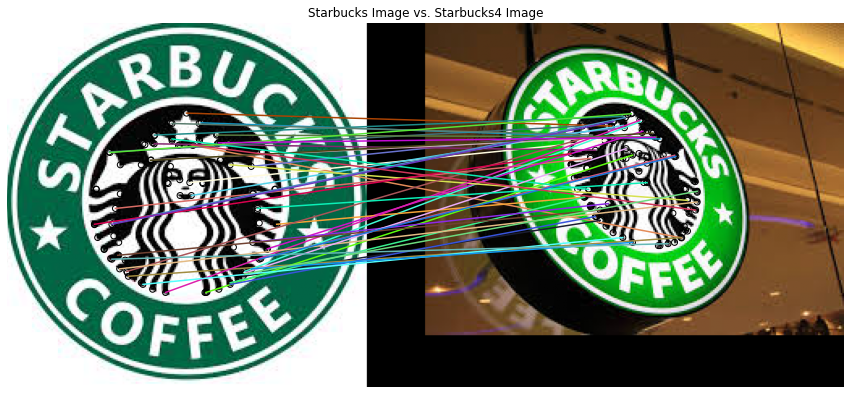

In [ ]:
# solution
starbucks_folder = os.path.join(parent_folder, 'images', 'starbucks')

starbucks_img = io.imread(os.path.join(starbucks_folder, 'starbucks.jpg'))
starbucks4_img = io.imread(os.path.join(starbucks_folder, 'starbucks4.jpg'))

# The image must be grayscale (2D array required)
starbucks_gray_img = color.rgb2gray(starbucks_img)
starbucks4_gray_img = color.rgb2gray(starbucks4_img)

# We use 100 keypoints to better visualize the images, and avoid having that many lines
starbucks_keypoints, starbucks4_keypoints, matches = get_ORB(starbucks_gray_img, starbucks4_gray_img, n_keypoints=100)

plt.rcParams["figure.figsize"] = (15, 10)

feature.plot_matches(plt, starbucks_img, starbucks4_img, starbucks_keypoints, starbucks4_keypoints, matches)

plt.axis('off')
plt.title("Starbucks Image vs. Starbucks4 Image")
plt.show()

### Exercise: #3

*   Using "starbucks.jpg" image as a model, show its matches to all Starbucks images. 
*   Show the number of the matches for the pair as title for each plot.

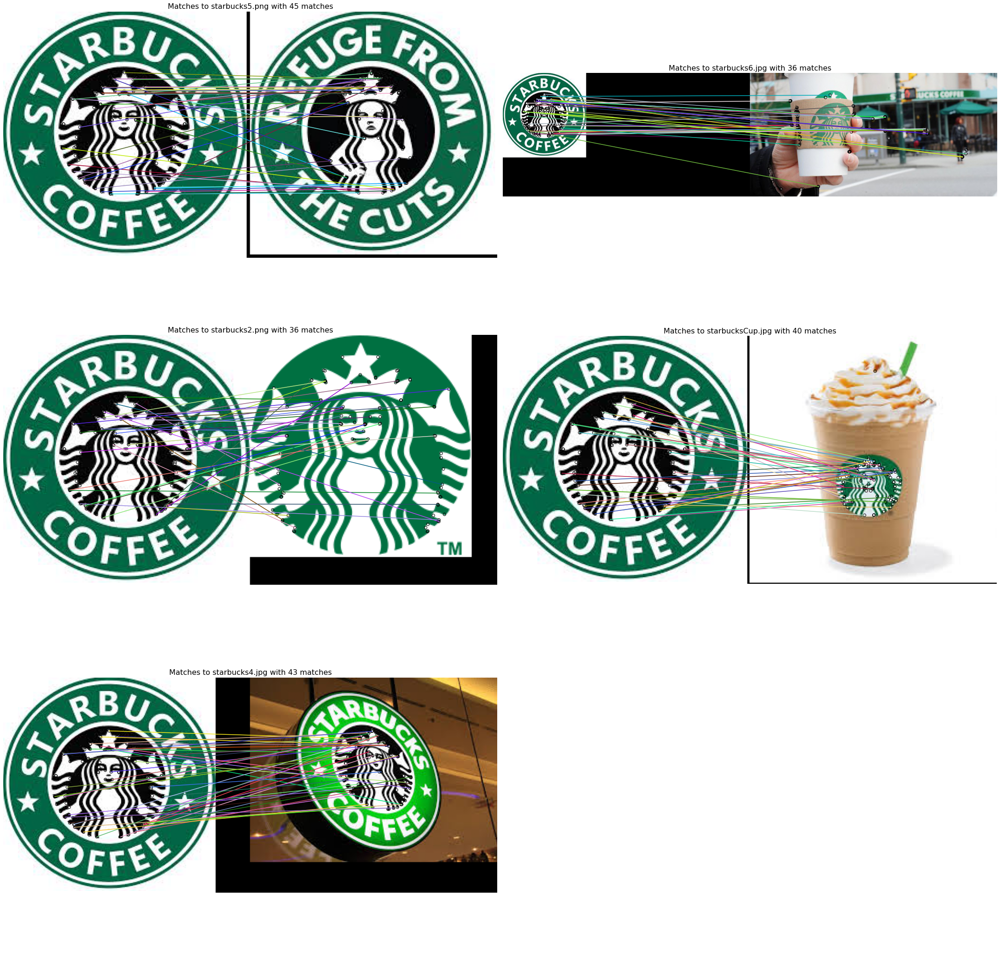

In [ ]:
# solution
images_names = os.listdir(starbucks_folder)
images_names = [image_name for image_name in images_names if image_name != 'starbucks.jpg']

fig, axs = plt.subplots(3, 2)
fig.set_size_inches(30, 30)
axs = axs.flatten()

# We are going to detect only 100 keypoints, and we are not going to filter them
n_keypoints = 100
max_ratio = 1.0

for i in range(len(images_names)):

    img = io.imread(os.path.join(starbucks_folder, images_names[i]))
    if img.shape[-1] == 4:
        img = color.rgba2rgb(img)
    gray_img = color.rgb2gray(img)

    template_keypoints, img_keypoints, matches = get_ORB(starbucks_gray_img, gray_img, n_keypoints, max_ratio)
    feature.plot_matches(axs[i], starbucks_img, img, template_keypoints, img_keypoints, matches)

    axs[i].axis('off')
    axs[i].set_title(f'Matches to {images_names[i]} with {matches.shape[0]} matches', fontdict = {'fontsize' : 16})

axs[-1].axis('off')
fig.tight_layout();

*   Comment on the performance of the algorithm with respect to each image. When do you think the algorithm works better?

**Solution**

First, we can see how even though we have detected 100 corners, only around 40 are matched in each image, meaning that more than half of them are unmatched. This is probably because of the `cross_match` parameter in `match_descriptor` to ensure that the matches are the best ones considering both directions.

Then, if we compare the results of the template with each image we have:

**starbucks5.png**  
Is the one with the biggest number of matches. We can see how most of the corners of the mermaid in the original logo are matched to the crown in the second right logo. This is because we have a great number of corners in the tails, and they have disappeared in the right image, matching with the crown or with the hair. We can see how the corners in the hair are mostly correctly matched.

**starbucks6.jpg**  
In this case, we can see how even though we have matches, they are all wrong. This is because the logo that appears in the cup is partly occluded by the hand, and the contrast of the brown with the green is not enough to be detected as a corner. Given that the "STARBUCKS" letters appearing in the cup are black and the contrast is bigger, most of the corners are detected there. Some of the found matches between the 2 images connect the logo with those letters. Other matches are with other parts of the right image where the contrast is big and they are detected as corners, but they do not have anything to do with the logo. The only match that we could consider correct is the one in the star corner from the occluded Starbucks logo in the right image, which matches with the same edge in the star placed over the crown (thanks to the cup being white and having more contrast).

**starbucks2.png**  
In this image, even though we have the same logo, the matches are not really good. Very few corners of the crown in the left image match with the crown in the second one. And the same happens with the corners in the tails in the left image. Looking closely, we can see the majority of the corners in the left image matching with the corners in the mermaid's face in the right image. A possible explanation is a different scale in the left logo because of the space occupied by the letters, as well as the green colour of the background in the right image.

**starbucksCup.jpg**  
In this image, we observe how almost every corner is detected in the Starbucks logo, probably because the contrast of the cup or the cream with the background is not enough to detect any kind of corner. Regarding the matches, we see how they are not that good either. We have some of them correctly matching corners in the crowns or the tails, but mostly they match incorrect parts. Probably it is because of the different scales of the logo, and the background colour.

**starbucks4.jpg**  
In this image, we can see how the matches are better with respect to other images. This is because the logos are the same in both images, but the right image is slightly rotated given the perspective where the photo was taken. In general, we have correct matches between the corners in both images, like for example in the crown. But as with the other images, there are some cases where the matched corners do not correspond, and this can be seen when the lines have a more pronounced slope.

**Summary:**

We can see that in those cases where the images are mostly the same, and only a linear transformation is applied (e.g. rotation), or when the images are in the same pose, but the image is slightly different, we observe overall good results. We indeed have wrong corners matched, but overall it matches similar parts of the images.  
The problem comes when the matched images present different colouring and contrast, leading to corners that need to be detected are not detected, matched corners that do not even correspond, and the matched corners that should be found are not found.

For example, we can try to filter matches in `starbucks6` that was giving the worse results:

Text(0.5, 1.0, 'Matches to starbucks6.jpg with 4 matches')

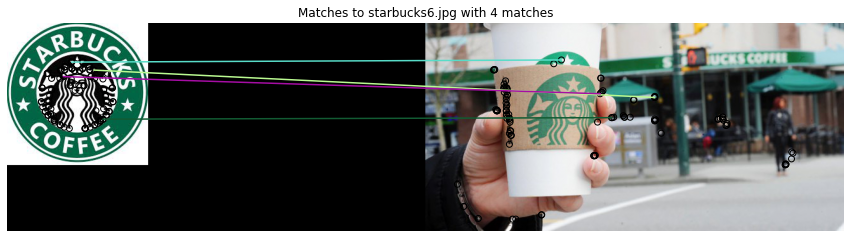

In [ ]:
n_keypoints = 100
max_ratio = 0.9

img = io.imread(os.path.join(starbucks_folder, 'starbucks6.jpg'))
if img.shape[-1] == 4:
    img = color.rgba2rgb(img)
gray_img = color.rgb2gray(img)

template_keypoints, img_keypoints, matches = get_ORB(starbucks_gray_img, gray_img, n_keypoints, max_ratio)
feature.plot_matches(plt, starbucks_img, img, template_keypoints, img_keypoints, matches)

plt.axis('off')
plt.title(f'Matches to starbucks6.jpg with {matches.shape[0]} matches');

We can see that by setting it to $0.9$ we are filtering almost all the matches, only leaving the only one we considered correct, and some others where there is high constrast. However, even with this extreme parameter setting, we find many "false positive" matches.

### Exercise: #4

*   Repeate **Exercise #2**, by changing the orientation of the model image by rotating it and comparing it with its original version.
*   Create 8 orientations of the model image by rotating the image by 45&deg; (0, 45, 90, 135, 180, 225, 270, 315). *Hint: You can use the rotate() function from skimage.transform.*

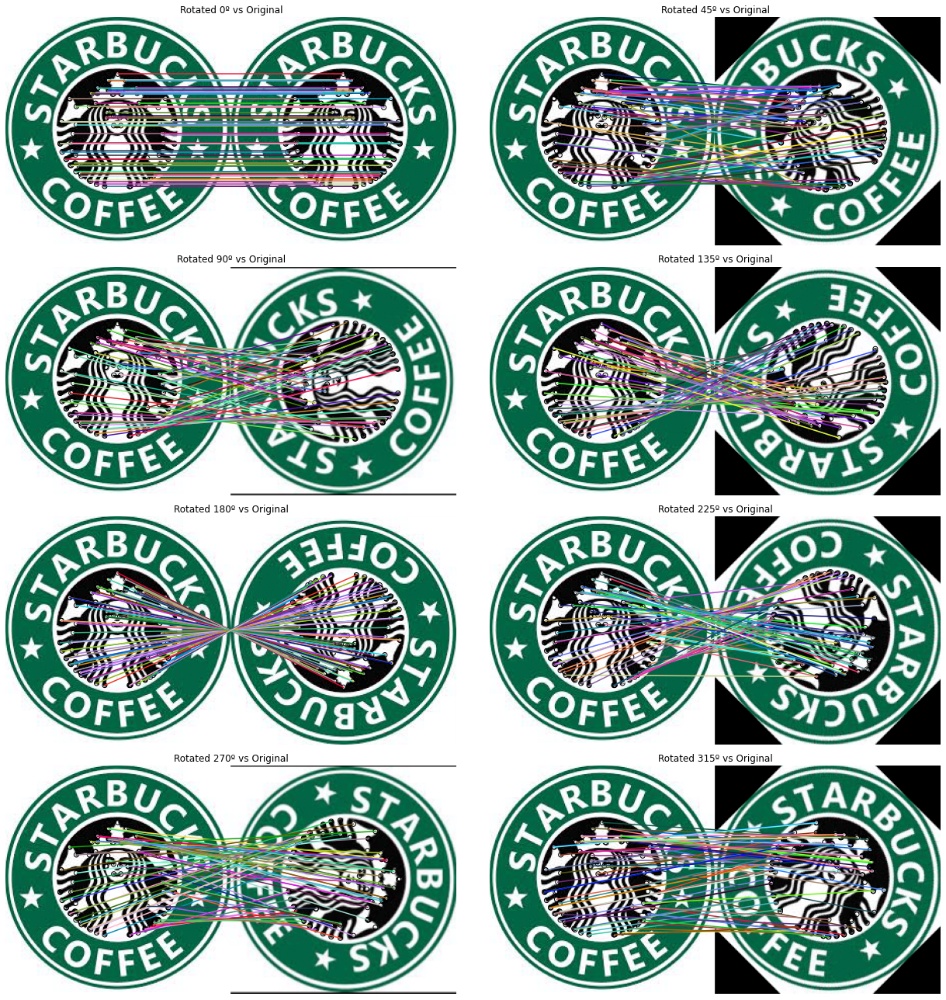

In [ ]:
# solution
starbucks_img = io.imread(os.path.join(starbucks_folder, 'starbucks.jpg'))
starbucks_gray_img = color.rgb2gray(starbucks_img)

fig, axs = plt.subplots(4, 2)
axs = axs.flatten()
fig.set_size_inches(18, 18)

rotations = [0, 45, 90, 135, 180, 225, 270, 315]

for i in range(len(rotations)):
    starbucks_rotated_img = transform.rotate(starbucks_img, rotations[i])
    starbucks_rotated_gray_img = color.rgb2gray(starbucks_rotated_img)

    template_keypoints, rotated_keypoints, matches = get_ORB(starbucks_gray_img, starbucks_rotated_gray_img, 100)

    feature.plot_matches(axs[i], starbucks_img, starbucks_rotated_img, template_keypoints, rotated_keypoints, matches)

    axs[i].axis('off')
    axs[i].set_title(f'Rotated {rotations[i]}º vs Original')

fig.tight_layout()

*   What do you observe with respect to the change in orientations?

**Solution**

We can observe that the ORB algorithm is in general very robust to the rotations. We can observe how the majority of corners are correctly matched in all the different orientations. There are indeed some corners wrongly matched since the rotation of 225º onwards. However, we can observe how in general the proportion of corners correctly matched is considerably bigger than those wrongly matched.

### Exercise: #5

*   Repeat **Exercise #3** using Coco-cola images using cocacola_logo.png as the model image.
*   Does the same parameters used for Starbucks images work in this case? Or was it necessary to modify the ORB parameters?

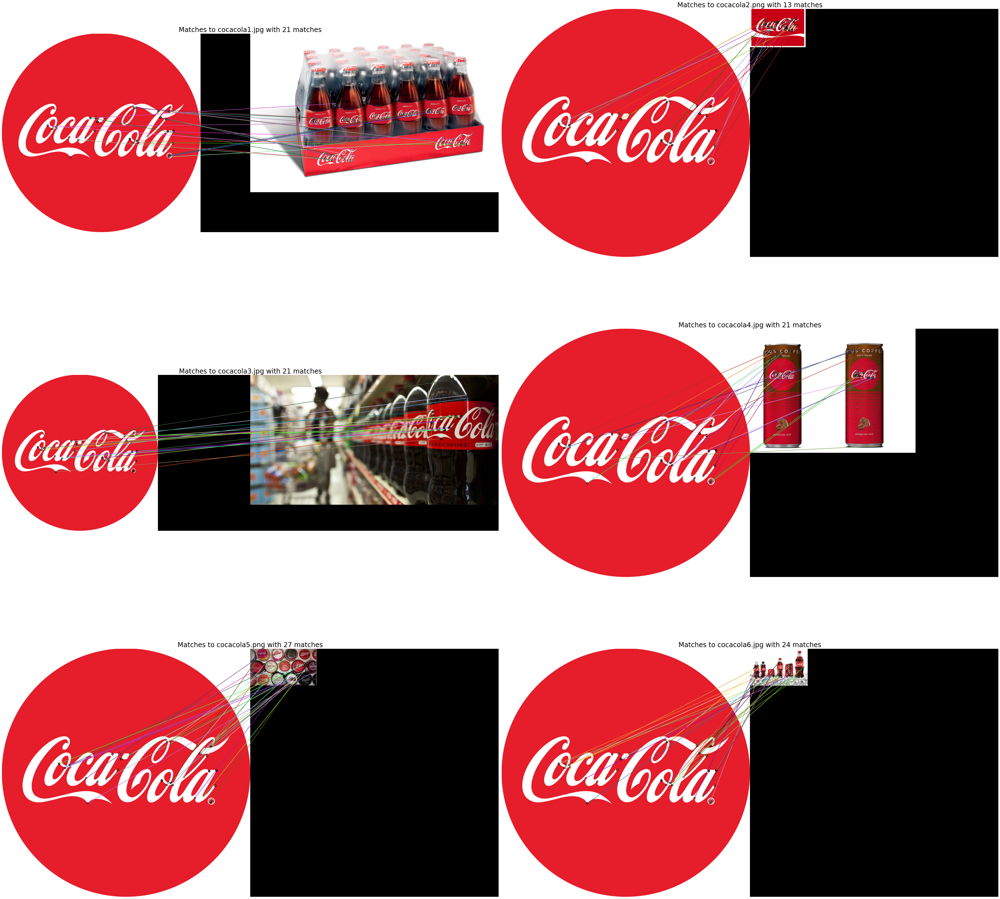

In [ ]:
# solution
cocacola_folder = os.path.join(parent_folder, 'images', 'cocacola')

cocacola_logo_img = io.imread(os.path.join(cocacola_folder, 'cocacola_logo.png'))
cocacola_logo_img = color.rgba2rgb(cocacola_logo_img)
cocacola_logo_gray_img = color.rgb2gray(cocacola_logo_img)

images_names = os.listdir(cocacola_folder)
images_names = [image_name for image_name in images_names if image_name != 'cocacola_logo.png']

fig, axs = plt.subplots(3, 2)
fig.set_size_inches(50, 50)
axs = axs.flatten()

# We are going to detect only 100 keypoints, and we are not going to filter them
n_keypoints = 100
max_ratio = 1.0

for i in range(len(images_names)):

    img = io.imread(os.path.join(cocacola_folder, images_names[i]))
    if img.shape[-1] == 4:
        img = color.rgba2rgb(img)
    gray_img = color.rgb2gray(img)

    template_keypoints, img_keypoints, matches = get_ORB(cocacola_logo_gray_img, gray_img, n_keypoints, max_ratio)
    feature.plot_matches(axs[i], cocacola_logo_img, img, template_keypoints, img_keypoints, matches)

    axs[i].axis('off')
    axs[i].set_title(f'Matches to {images_names[i]} with {matches.shape[0]} matches', fontdict = {'fontsize' : 24})

fig.tight_layout()

**Solution**

We want to notice that we have plotted the results in a big figure to be able to distinguish the matches. Given that the Coca-Cola logo image used as a template is very big in comparison with the others, seeing the results otherwise was impossible.  
If you perform a double click in the resulting plots the image will zoom and you can scroll to see a particular matching.

We have tried the same parameters as with the Starbucks images (i.e. 100 keypoints and 1.0 `max_ratio`), and the results are similar to the ones with Starbucks. If we do not change the `max_ratio` we are not filtering matches in any sense, resulting in more incorrect matches like the ones with the Coca-Cola coffee cans, where the word "Coca-Cola" of the logo is matched with the words "Plus Cofee" and "Sin Azúcar". This is because both letters are white with a red background, and the letters in the right image are not cursive and corners are found there.  
Another example can be seen when matching corners with the image containing the cans, plastic bottles and glass bottles. There we can see matches with corners found in the places where the contrast changes because the bottle is not full up to the cap.

In all the images compared with the template, the same logo was displayed, and corners were found there. Thus, we found matches between the logos. However, the matched corners do not match, even though the same logo is in both images. Mainly, because of the space ratio the logo takes up the complete image. For example, when comparing the two images with only the Coca-Cola logos, we can see how the corners found in the registered trademark symbol match with corners from other letters given that the same symbol is very small in the right image, and no corner is found there. Therefore, it is sensitive to scale differences.

If we try a smaller value of `max_ratio`, we should see less wrong matches, as we would filter them:

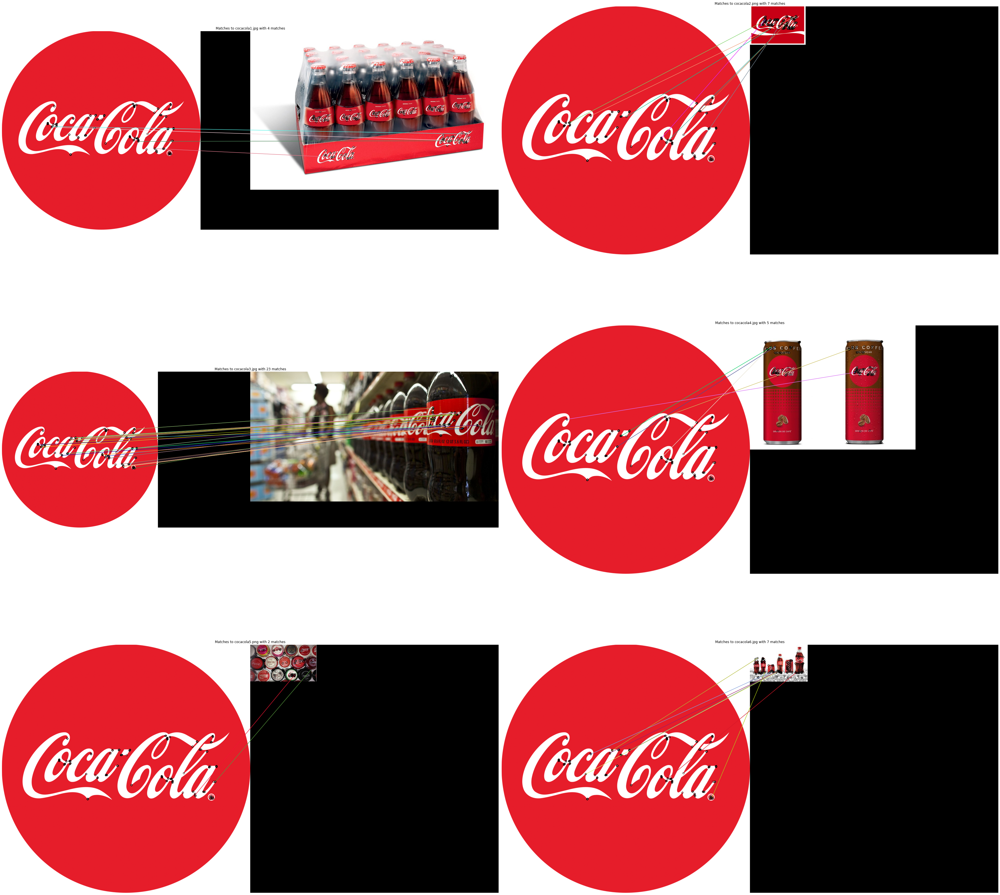

In [ ]:
fig, axs = plt.subplots(3, 2)
fig.set_size_inches(50, 50)
axs = axs.flatten()

n_keypoints = 100
max_ratio = 0.85

for i in range(len(images_names)):

    img = io.imread(os.path.join(cocacola_folder, images_names[i]))
    if img.shape[-1] == 4:
        img = color.rgba2rgb(img)
    gray_img = color.rgb2gray(img)

    template_keypoints, img_keypoints, matches = get_ORB(cocacola_logo_gray_img, gray_img, n_keypoints, max_ratio)
    feature.plot_matches(axs[i], cocacola_logo_img, img, template_keypoints, img_keypoints, matches)

    axs[i].axis('off')
    axs[i].set_title(f'Matches to {images_names[i]} with {matches.shape[0]} matches', fontdict = {'fontsize' : 24})

fig.tight_layout()

We can see how we are filtering quite a few matches, but the ones remaining are still matching incorrect corners from both images. That is why, we could conclude that even though we change parameters, we will still have some incorrect matches because the images are not the same in colours, scale, and pose.

### Exercise #6. Analysis of the applied techniques and results

*   What are the advantages of ORB object detection compared with HOG object detector?

**Solution**

ORB is more robust to transformations applied to the image. We have seen how we can detect objects even though the image is rotated and scaled, and we saw how we had problems with that using HOGs, especially rotation, given that with HOGs we use the gradient orientation.

Detecting objects with ORB is easier than with HOGs, given that we do not have to manually apply a sliding window and try to match that region with the descriptors of the template obtained with HOGs. Instead, we compute the corners and descriptors of the complete image, compare the descriptors with those of the template, and decide if the object is present or not based on the matches obtained (e.g. setting a minimum number of matches as threshold).

Another advantage is the fact that with ORB we can understand the results easier than with HOGs, given that the keypoints are directly pixels that we later transform to binary vectors, whereas with HOG we are computing histograms of gradient orientations, which can be more difficult to understand or visualize.

Finally, another benefit of ORB is that we are not detecting that many keypoints that we were detecting with HOG, which sometimes were not really useful but mainly noise.

*   What would happen if you analyse an image that does not contain the Starbucks logo (as is the case of "edificio.jpg")?

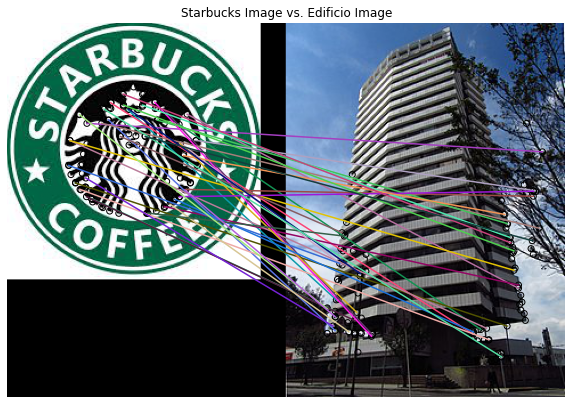

<Figure size 720x720 with 0 Axes>

In [ ]:
# solution
edificio_img = io.imread(os.path.join(parent_folder, 'images', 'edificio.jpg'))
edificio_gray_img = color.rgb2gray(edificio_img)

starbucks_img = io.imread(os.path.join(starbucks_folder, 'starbucks.jpg'))
starbucks_gray_img = color.rgb2gray(starbucks_img)

template_keypoints, img_keypoints, matches = get_ORB(starbucks_gray_img, edificio_gray_img, n_keypoints=100)
feature.plot_matches(plt, starbucks_img, edificio_img, template_keypoints, img_keypoints, matches)

plt.rcParams["figure.figsize"] = (10, 10)

plt.axis('off')
plt.title("Starbucks Image vs. Edificio Image")
plt.show()
plt.tight_layout()

**Solution**

As we can see, in `edificio.jpg` image we detect corners in places where one could expect to find them, particularly in this kind of white panels. It is curious, however, that the corners are mainly detected in the more outside places, where the sky is present. Probably this is because of the contrast change in the sky, full of more whitish pixels that the FAST algorithm considers a corner.

In terms of matches, we can see how mainly the matches are between the corners detected in the mermaid part of the Starbucks logo, with the corners of those mentioned white panels contrasting with the sky. This is because we can see this similar kind of white-striped pattern in the building as well as in the mermaid tail and hair.
We can also see matches with some parts of the tree. Probably because the tree is mainly black in the grey image, and again with the contrast of the sky, corners are detected and matched with similar corners on the mermaid. We also have matches with the streetlight, as well as with the traffic signs.

Therefore, we can see how we can detect corners in both images, but because both images are completely different, the matches are produced again because we are not filtering them with the `max_ratio` parameter. If we apply the parameter, for example with a value of $0.9$, we can observe the following:

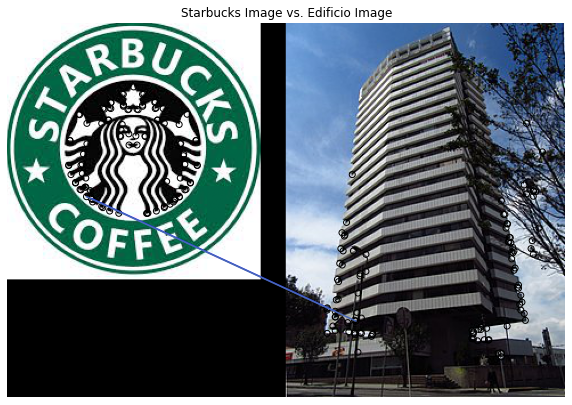

<Figure size 720x720 with 0 Axes>

In [ ]:
template_keypoints, img_keypoints, matches = get_ORB(starbucks_gray_img, edificio_gray_img, n_keypoints=100, max_ratio=0.9)
feature.plot_matches(plt, starbucks_img, edificio_img, template_keypoints, img_keypoints, matches)

plt.rcParams["figure.figsize"] = (10, 10)

plt.axis('off')
plt.title("Starbucks Image vs. Edificio Image")
plt.show()
plt.tight_layout()

As we can see, we only obtain a single match. This is probably because the distances of the matches for a corner in the first image with the corners of the second image are similar, meaning that we are mainly obtaining ambiguous matches. After all, the 2 images are completely different.

*   What are the different ways of defining a quality measure for the correspondance between two images? (implementation of measures is not necessary)?

**Solution**

We know some approaches that can be used to compare two images, like template matching or HOG. Another simpler approach is based on comparing the normalized RGB histograms of two images (globally or patch-based).

Additionally, we can come up with some alternatives using the techniques studied in this lab:
* We can take into account the orientation of the match line. For example, if the image is not rotated with respect to the other, a true match should be represented by a horizontal arrow. It is true, however, that if the scale is not the same, this quality measure has flaws. Another (less strict) variant of this measure could be checking whether or not the different matching lines have a similar direction and length. This could make the measure more robust to displacements.
* We can consider the ratio of matches we are not filtering as ambiguous when using the `max_ratio` parameter with respect to the complete set of matches when we do not perform any filtering.
* Another option could be comparing the relative distance between points in the original image and the new one. For example, the ratio of the distance from $A$ to $B$ and $A$ to $C$ should remain constant (or very similar) for every three keypoints $A$, $B$ and $C$. This option would be more robust to rotations than the first one we have proposed.

# Panorama Stitching (Not graded)

Image Mosaicing is a technique of combining multiple overlapping images into a single image.

*   A simple tutorial can be found in this notebook: 
*   https://github.com/scikit-image/skimage-tutorials/blob/main/lectures/solutions/adv3_panorama-stitching-solution.ipynb

<a name="app-a"></a>
# Appendix A

## Harris corner detector

The main idea behind that algorithms is that if a point is a corner, there must be great changes around it in 2 directions:

![Image from https://medium.com/data-breach/introduction-to-harris-corner-detector-32a88850b3f6](https://miro.medium.com/max/594/0*PPJxP5y_k4GCWLBM.jpg)

*Image from https://medium.com/data-breach/introduction-to-harris-corner-detector-32a88850b3f6*

In order to measure that, the algorithm computes the gradient of the intensity in a given window around the pixel we are evaluating in both $x$ and $y$. Then, the algorithm follows an approach similar to PCA, substracting the mean to the computed gradients and buiding the $2\times 2$ covariance matrix ($M$). Now, if we call $\lambda_1$ and $\lambda_2$ the eigenvalues of such a matrix, it is clear that the relationships in the image below are true:

![Image from https://opencv24-python-tutorials.readthedocs.io/](https://opencv24-python-tutorials.readthedocs.io/en/latest/_images/harris_region.jpg)

*Image from https://opencv24-python-tutorials.readthedocs.io/*


In order to compute the response image based on those observations, the `sklearn` library provides two possible methods (controlled via the `method` parameter):
- In de default approach
$$
R = det(M) - k \cdot trace(M)^2 = \lambda_1 \cdot\lambda_2 - k \cdot (\lambda_1 +\lambda_2)^2
$$
where $k\in[0.04,0.06]$ (according to the [Wikipedia](https://en.wikipedia.org/wiki/Harris_corner_detector)), with a default value of $0.05$ in `sklearn`.
- Otherwise
$$
R = 2 \cdot \frac{det(M)}{trace(M)+\varepsilon} = 2 \cdot \frac{ \lambda_1 \cdot\lambda_2}{\lambda_1 +\lambda_2+\varepsilon}
$$
where $\varepsilon$ is a normalization factor. Thus, we are using the smallest eigenvalue as an estimation of the response.


---

## **End of P2_2: Corner Detection and ORB**
Deadline for P2_2 submission in CampusVirtual is: **Monday, the 8th of November, 2021**
